In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [ ]:
!pip install bertviz

In [ ]:
import pandas as pd
import numpy as np
import math
import matplotlib.pyplot as plt
import torch
import os
from torch import nn, optim, device, cuda, Tensor, LongTensor, argmax, bincount
from sklearn.metrics import accuracy_score, confusion_matrix, ConfusionMatrixDisplay, precision_score, recall_score, f1_score
from transformers import BertForSequenceClassification, BertTokenizer, get_linear_schedule_with_warmup
from tqdm import tqdm
import random

In [ ]:
MAX_EPOCHS = 2
LEARNING_RATE = 2.20E-05
BATCH_SIZE = 32
MAX_LENGTH = 250

SAVE_MODEL = True
MODEL_FOLDER = '/content/drive/MyDrive/models/model_bert_52'
DATASET_TRAIN = '/content/drive/MyDrive/School/Thesis - Hate Speech/Data/dataset-train.csv'
DATASET_TEST = '/content/drive/MyDrive/School/Thesis - Hate Speech/Data/dataset-test.csv'

DEVICE = torch.device('cuda' if torch.cuda.is_available() else 'cpu')


In [ ]:
if SAVE_MODEL:
  os.makedirs(
    MODEL_FOLDER,
    exist_ok=True, # Create folder if it doesn't exist, else do nothing
  )

  print(f"Saving model at '{MODEL_FOLDER}'")

Saving model at '/content/drive/MyDrive/models/model_bert_52'


In [ ]:
def read_csv_file(filename: str) -> pd.DataFrame:
    try:
        data = pd.read_csv(filename, lineterminator='\n', usecols=range(2))
        print("CSV file read successfully!")
        return data
    except FileNotFoundError:
        print("ERROR: File not found")
        exit(1)

dataset_train = read_csv_file(DATASET_TRAIN)
dataset_test = read_csv_file(DATASET_TEST)

CSV file read successfully!
CSV file read successfully!


In [ ]:
dataset_train

,text,label
0,Matthew Chang [USERNAME] Remind ko lang di ba ...,1
1,Yay! The interview served its purpose wellJess...,0
2,I say DASURV,0
3,TayNew said Let Leni Lead,0
4,Gloc 9 is not endorsing Jejomar Binay as his p...,0
...,...,...
22764,Nov. 11: on [USERNAME] saw tv ads of Jojo Bina...,1
22765,Mar Roxas your call for unity describes one th...,1
22766,Buti nalang nagdecide nakong hindi manood ng T...,0
22767,sang boto para sa pagbabago. Let Leni Lead phi...,0


In [ ]:
dataset_test

,text,label
0,Hindi susuportahan ng theatre and literary est...,0
1,BABAE LABAN SA FAKE AT FRAUDBFFSUMBONGDAYA DES...,1
2,Im proud to be a Filipino and a kakampink like...,0
3,Grabe noThe hypocrisy of the church to preach ...,1
4,BBMSARAUniteam Ph Arena BBMSARA,0
...,...,...
5687,[USERNAME] Rizalito David is a good man you ca...,0
5688,A very famous religious cult in the Philippine...,1
5689,Tama sir VP Leni Di dapat iboto SI BBM Kase No...,0
5690,RT [USERNAME]: Mar Roxas forever arrogantI can...,1


In [ ]:
X_train = dataset_train['text']
y_train = dataset_train['label']

X_test = dataset_test['text']
y_test = dataset_test['label']

In [ ]:
_model_name = "bert-base-multilingual-uncased"

model = BertForSequenceClassification.from_pretrained(
    _model_name,
    num_labels=2,
).to(DEVICE)

/usr/local/lib/python3.10/dist-packages/huggingface_hub/utils/_token.py:88: UserWarning: 
The secret `HF_TOKEN` does not exist in your Colab secrets.
To authenticate with the Hugging Face Hub, create a token in your settings tab (https://huggingface.co/settings/tokens), set it as secret in your Google Colab and restart your session.
You will be able to reuse this secret in all of your notebooks.
Please note that authentication is recommended but still optional to access public models or datasets.
  warnings.warn(
Some weights of BertForSequenceClassification were not initialized from the model checkpoint at bert-base-multilingual-uncased and are newly initialized: ['classifier.bias', 'classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


In [ ]:
tokenizer = BertTokenizer.from_pretrained(_model_name)

In [ ]:
def tokenize_and_prepare(texts, tokenizer, max_length):
    input_ids = []
    attention_masks = []
    tokens_list = []

    for text in tqdm(texts, desc="Tokenizing"):
        # Tokenize the text
        tokens = tokenizer.tokenize(text)

        # Truncate the tokens if necessary
        if len(tokens) > max_length - 2:
            tokens = tokens[:max_length - 2]

        # Add special tokens
        tokens = ['[CLS]'] + tokens + ['[SEP]']

        # Convert tokens to token IDs
        token_ids = tokenizer.convert_tokens_to_ids(tokens)

        # Pad the token IDs to max_length
        padding = [0] * (max_length - len(token_ids))
        token_ids += padding

        # Create attention mask
        attention_mask = [1] * len(tokens) + [0] * len(padding)

        input_ids.append(token_ids)
        attention_masks.append(attention_mask)
        tokens_list.append(tokens)  # Append the tokens to the list

    # Convert lists to tensors
    input_ids = torch.tensor(input_ids)
    attention_masks = torch.tensor(attention_masks)

    return input_ids, attention_masks, tokens_list

# Tokenize and prepare the data with progress bars
print("Tokenizing training data...")
train_input_ids, train_attention_masks, train_tokens = tokenize_and_prepare(X_train, tokenizer, MAX_LENGTH)
print("Training data tokenized.")

print("Tokenizing test data...")
test_input_ids, test_attention_masks, test_tokens = tokenize_and_prepare(X_test, tokenizer, MAX_LENGTH)
print("Test data tokenized.")

# Convert labels into tensors
train_labels = torch.tensor(y_train)
test_labels = torch.tensor(y_test)

Tokenizing training data...


Tokenizing: 100%|██████████| 22769/22769 [00:11<00:00, 2006.76it/s]


Training data tokenized.
Tokenizing test data...


Tokenizing: 100%|██████████| 5692/5692 [00:02<00:00, 2044.00it/s]


Test data tokenized.


In [ ]:
# Print the original text, tokens, input IDs, and attention mask for the first few examples
num_examples = 5  # Number of examples to display

for i in range(num_examples):
    print(f"Example {i+1}:")
    print("Original Text:", X_train.iloc[i])
    print("Tokens:", ' '.join(train_tokens[i][:MAX_LENGTH]))
    print("Input IDs:", ' '.join(map(str, train_input_ids[i][:MAX_LENGTH].tolist())))
    print("Attention Mask:", ' '.join(map(str, train_attention_masks[i][:MAX_LENGTH].tolist())))
    print()

Example 1:
Original Text: Matthew Chang [USERNAME] Remind ko lang di ba galit na galit ka dun sa taong di marunong magbayad ng utang? Tapos kay marcos hindi iboboto mo pa? Well Marcos Magnanakaw Never Again
Tokens: [CLS] matthew chang [ user ##name ] remi ##nd ko lang di ba gali ##t na gali ##t ka dun sa taong di maru ##non ##g mag ##bay ##ad ng utan ##g ? tapo ##s kay marcos hindi ib ##obo ##to mo pa ? well marcos magna ##nak ##aw never again [SEP]
Input IDs: 101 18569 20959 138 24934 23993 140 87397 11408 11236 11804 10120 12314 26802 10123 10135 26802 10123 10237 20010 10105 76876 10120 90248 18453 10251 18115 75992 11655 10822 13253 10251 136 29760 10107 11040 23893 18465 47810 62815 10366 10837 10202 136 11327 23893 38035 12271 29274 13362 12590 102 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0

In [ ]:
pd.DataFrame(train_input_ids)

,0,1,2,3,4,5,6,7,8,9,...,240,241,242,243,244,245,246,247,248,249
0,101,18569,20959,138,24934,23993,140,87397,11408,11236,...,0,0,0,0,0,0,0,0,0,0
1,101,10593,10158,106,10103,16705,12567,10491,23272,11327,...,0,0,0,0,0,0,0,0,0,0
2,101,151,16497,10216,10585,10434,102,0,0,0,...,0,0,0,0,0,0,0,0,0,0
3,101,13918,10220,10650,12338,12421,14537,10116,13868,102,...,0,0,0,0,0,0,0,0,0,0
4,101,68763,20731,130,10127,10497,11421,19249,10285,12678,...,0,0,0,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
22764,101,21630,119,10170,131,10125,138,24934,23993,140,...,0,0,0,0,0,0,0,0,0,0
22765,101,11337,17675,54004,12787,15810,10139,40345,34346,10399,...,0,0,0,0,0,0,0,0,0,0
22766,101,39777,69734,10422,28561,10282,43551,13278,10251,18465,...,0,0,0,0,0,0,0,0,0,0
22767,101,12673,14739,10132,10239,10105,10781,57631,26773,119,...,0,0,0,0,0,0,0,0,0,0


In [ ]:
pd.DataFrame(train_attention_masks)

,0,1,2,3,4,5,6,7,8,9,...,240,241,242,243,244,245,246,247,248,249
0,1,1,1,1,1,1,1,1,1,1,...,0,0,0,0,0,0,0,0,0,0
1,1,1,1,1,1,1,1,1,1,1,...,0,0,0,0,0,0,0,0,0,0
2,1,1,1,1,1,1,1,0,0,0,...,0,0,0,0,0,0,0,0,0,0
3,1,1,1,1,1,1,1,1,1,1,...,0,0,0,0,0,0,0,0,0,0
4,1,1,1,1,1,1,1,1,1,1,...,0,0,0,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
22764,1,1,1,1,1,1,1,1,1,1,...,0,0,0,0,0,0,0,0,0,0
22765,1,1,1,1,1,1,1,1,1,1,...,0,0,0,0,0,0,0,0,0,0
22766,1,1,1,1,1,1,1,1,1,1,...,0,0,0,0,0,0,0,0,0,0
22767,1,1,1,1,1,1,1,1,1,1,...,0,0,0,0,0,0,0,0,0,0


In [ ]:
# Step 1: Access the sentences at indices 1 and 2490
sentence_1 = X_train.iloc[1]
sentence_2490 = X_train.iloc[2490]

# Step 2: Create a DataFrame with the sentences of rows 1 and 2490
df_sentences = pd.DataFrame({'Row 1': [sentence_1], 'Row 2490': [sentence_2490]})

# Print the DataFrame
print("Original Sentences of Rows 1 and 2490:")
df_sentences

Original Sentences of Rows 1 and 2490:


,Row 1,Row 2490
0,Yay! The interview served its purpose wellJess...,[USERNAME] In the beginningonly Binay. But the...


In [ ]:
# Step 1: Access the attention masks at indices 1 and 2490
attention_mask_1 = train_attention_masks[1]
attention_mask_2490 = train_attention_masks[2490]
# Step 2: Create a DataFrame with the attention masks of rows 1 and 2490
df_attention_masks = pd.DataFrame([attention_mask_1, attention_mask_2490],
                                  index=['Row 1', 'Row 2490'],
                                  columns=[f'mask_{i}' for i in range(len(attention_mask_1))])
# Print the DataFrame
print("Attention Masks of Rows 1 and 2490:")
df_attention_masks

Attention Masks of Rows 1 and 2490:


,mask_0,mask_1,mask_2,mask_3,mask_4,mask_5,mask_6,mask_7,mask_8,mask_9,...,mask_240,mask_241,mask_242,mask_243,mask_244,mask_245,mask_246,mask_247,mask_248,mask_249
Row 1,tensor(1),tensor(1),tensor(1),tensor(1),tensor(1),tensor(1),tensor(1),tensor(1),tensor(1),tensor(1),...,tensor(0),tensor(0),tensor(0),tensor(0),tensor(0),tensor(0),tensor(0),tensor(0),tensor(0),tensor(0)
Row 2490,tensor(1),tensor(1),tensor(1),tensor(1),tensor(1),tensor(1),tensor(1),tensor(1),tensor(1),tensor(1),...,tensor(0),tensor(0),tensor(0),tensor(0),tensor(0),tensor(0),tensor(0),tensor(0),tensor(0),tensor(0)


In [ ]:
# Step 1: Access the sentences at indices 1 and 296
sentence_1 = X_test.iloc[1]
sentence_296 = X_test.iloc[296]

# Step 2: Create a DataFrame with the sentences of rows 1 and 296
df_sentences = pd.DataFrame({'Row 1': [sentence_1], 'Row 296': [sentence_296]})

# Print the DataFrame
print("Original Sentences of Rows 1 and 296:")
df_sentences

Original Sentences of Rows 1 and 296:


,Row 1,Row 296
0,BABAE LABAN SA FAKE AT FRAUDBFFSUMBONGDAYA DES...,NAKAKAASAR YUNG COMMERCIAL NI BINAY. Pota


In [ ]:
# Step 1: Access the attention masks at indices 1 and 296
attention_mask_1 = test_attention_masks[1]
attention_mask_296 = test_attention_masks[296]
# Step 2: Create a DataFrame with the attention masks of rows 1 and 296
df_attention_masks = pd.DataFrame([attention_mask_1, attention_mask_296],
                                  index=['Row 1', 'Row 296'],
                                  columns=[f'mask_{i}' for i in range(len(attention_mask_1))])
# Print the DataFrame
df_attention_masks

,mask_0,mask_1,mask_2,mask_3,mask_4,mask_5,mask_6,mask_7,mask_8,mask_9,...,mask_240,mask_241,mask_242,mask_243,mask_244,mask_245,mask_246,mask_247,mask_248,mask_249
Row 1,tensor(1),tensor(1),tensor(1),tensor(1),tensor(1),tensor(1),tensor(1),tensor(1),tensor(1),tensor(1),...,tensor(0),tensor(0),tensor(0),tensor(0),tensor(0),tensor(0),tensor(0),tensor(0),tensor(0),tensor(0)
Row 296,tensor(1),tensor(1),tensor(1),tensor(1),tensor(1),tensor(1),tensor(1),tensor(1),tensor(1),tensor(1),...,tensor(0),tensor(0),tensor(0),tensor(0),tensor(0),tensor(0),tensor(0),tensor(0),tensor(0),tensor(0)


In [ ]:
def shuffle_train_data(train_input_ids, train_attention_masks, train_labels):
    # Combine the training data into a list of tuples
    train_data = list(zip(train_input_ids, train_attention_masks, train_labels))

    # Shuffle the training data
    random.shuffle(train_data)

    # Unpack the shuffled training data
    train_input_ids, train_attention_masks, train_labels = zip(*train_data)

    # Convert the unpacked data back to tensors
    train_input_ids = torch.stack(train_input_ids)
    train_attention_masks = torch.stack(train_attention_masks)
    train_labels = torch.stack(train_labels)

    return train_input_ids, train_attention_masks, train_labels

In [ ]:
def save_checkpoint(
    model: nn.Module,
    optimizer,
    epoch: int,
):
    checkpoint_path = f'{MODEL_FOLDER}/bert_checkpoint.pth'
    torch.save({
        'model': model.state_dict(),
        'optimizer': optimizer.state_dict(),
    }, checkpoint_path)

    print(f"Saved checkpoint of epoch {epoch} at '{checkpoint_path}'")

def load_checkpoint():
    checkpoint_path = f'{MODEL_FOLDER}/bert_checkpoint.pth'
    try:
        checkpoint = torch.load(checkpoint_path)
        if checkpoint.keys() < {
            'model',
            'optimizer',
        }:
            print("ERROR: Checkpoint is the incorrect format")
            return None
        return checkpoint
    except FileNotFoundError:
        print(f"Checkpoint not found. Starting from scratch.")
        return None

In [ ]:
# Custom data loader
def data_loader(input_ids, attention_masks, labels, batch_size):
    for i in range(0, len(input_ids), batch_size):
        yield input_ids[i:i+batch_size], attention_masks[i:i+batch_size], labels[i:i+batch_size]

optimizer = optim.Adam(model.parameters(), lr=LEARNING_RATE)
loss_function = nn.CrossEntropyLoss()

loss_values = []
accuracy_values = []
precision_values = []
recall_values = []
f1_values = []

checkpoint_accuracy = load_checkpoint()

if checkpoint_accuracy:
    # Load checkpoint data
    model.load_state_dict(checkpoint_accuracy['model'])
    optimizer.load_state_dict(checkpoint_accuracy['optimizer'])

loss_values = []
accuracy_values = []
precision_values = []
recall_values = []
f1_values = []
top_accuracy = 0

epoch_start = 1
for epoch in range(MAX_EPOCHS):
    model.train()
    train_loss = 0

    # Shuffle the training data after each epoch (starting from the second epoch)
    if epoch > 0:
        train_input_ids, train_attention_masks, train_labels = shuffle_train_data(
            train_input_ids, train_attention_masks, train_labels
        )

    train_progress_bar = tqdm(data_loader(train_input_ids, train_attention_masks, train_labels, BATCH_SIZE), desc=f"Epoch {epoch+1} Training", leave=False)

    for batch_input_ids, batch_attention_masks, batch_labels in train_progress_bar:
        batch_input_ids = batch_input_ids.to(DEVICE)
        batch_attention_masks = batch_attention_masks.to(DEVICE)
        batch_labels = batch_labels.to(DEVICE)

        optimizer.zero_grad()
        outputs = model(batch_input_ids, attention_mask=batch_attention_masks)
        loss = loss_function(outputs.logits, batch_labels)
        train_loss += loss.item()
        loss.backward()
        optimizer.step()

        train_progress_bar.set_postfix({"Loss": loss.item()})

    train_loss /= len(train_input_ids) // BATCH_SIZE
    loss_values.append(train_loss)

    model.eval()
    with torch.no_grad():
        y_pred = []
        y_true = []
        test_progress_bar = tqdm(data_loader(test_input_ids, test_attention_masks, test_labels, BATCH_SIZE), desc=f"Epoch {epoch+1} Testing", leave=False)

        for batch_input_ids, batch_attention_masks, batch_labels in test_progress_bar:
            batch_input_ids = batch_input_ids.to(DEVICE)
            batch_attention_masks = batch_attention_masks.to(DEVICE)
            batch_labels = batch_labels.to(DEVICE)

            outputs = model(batch_input_ids, attention_mask=batch_attention_masks)
            predictions = argmax(outputs.logits, dim=1)
            y_pred.extend(predictions.cpu().numpy())
            y_true.extend(batch_labels.cpu().numpy())

        test_progress_bar.close()

        accuracy = accuracy_score(y_true, y_pred)
        precision = precision_score(y_true, y_pred)
        recall = recall_score(y_true, y_pred)
        f1 = f1_score(y_true, y_pred)

        accuracy_values.append(accuracy)
        precision_values.append(precision)
        recall_values.append(recall)
        f1_values.append(f1)

        if accuracy > top_accuracy:
            top_accuracy = accuracy
            save_checkpoint(
                model,
                optimizer,
                epoch + 1,
            )

        print(f"Epoch {epoch + 1} | Train Loss: {train_loss:.4f} | Test Accuracy: {accuracy:.4f} | Precision: {precision:.4f} | Recall: {recall:.4f} | F1 Score: {f1:.4f}")

        # Save the metrics for each epoch
        epoch_results_df = pd.DataFrame({
            'epoch': [epoch + 1],
            'loss': [train_loss],
            'accuracy': [accuracy],
            'precision': [precision],
            'recall': [recall],
            'f1': [f1]
        })
        epoch_results_df.to_csv(f'{MODEL_FOLDER}/bert_results.csv', mode='a', header=not os.path.exists(f'{MODEL_FOLDER}/bert_results.csv'), index=False)

Checkpoint not found. Starting from scratch.


Saved checkpoint of epoch 1 at '/content/drive/MyDrive/models/model_bert_52/bert_checkpoint.pth'
Epoch 1 | Train Loss: 0.4244 | Test Accuracy: 0.8403 | Precision: 0.8505 | Recall: 0.8289 | F1 Score: 0.8395


Saved checkpoint of epoch 2 at '/content/drive/MyDrive/models/model_bert_52/bert_checkpoint.pth'
Epoch 2 | Train Loss: 0.3069 | Test Accuracy: 0.8512 | Precision: 0.8122 | Recall: 0.9167 | F1 Score: 0.8613


In [ ]:
best_checkpoint = load_checkpoint()
if best_checkpoint:
    model.load_state_dict(best_checkpoint['model'])
    print(f"Loaded best checkpoint")

Loaded best checkpoint


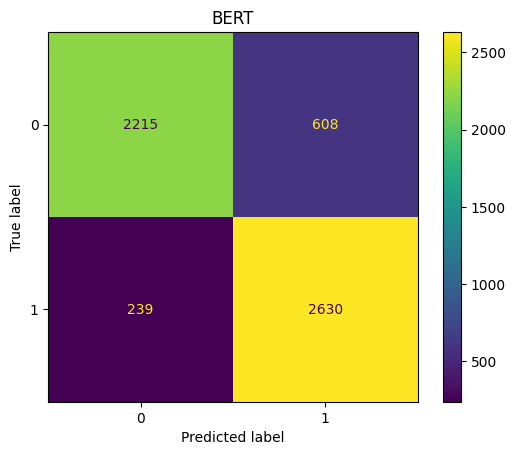

In [ ]:
y_pred = []
y_true = []

with torch.no_grad():
    for batch_input_ids, batch_attention_masks, batch_labels in data_loader(test_input_ids, test_attention_masks, test_labels, BATCH_SIZE):
        batch_input_ids = batch_input_ids.to(DEVICE)
        batch_attention_masks = batch_attention_masks.to(DEVICE)
        batch_labels = batch_labels.to(DEVICE)

        outputs = model(batch_input_ids, attention_mask=batch_attention_masks)
        predictions = argmax(outputs.logits, dim=1)
        y_pred.extend(predictions.cpu().numpy())
        y_true.extend(batch_labels.cpu().numpy())

conf_matrix = confusion_matrix(y_true, y_pred)
conf_matrix_display = ConfusionMatrixDisplay(conf_matrix)
conf_matrix_display.plot()
plt.title("BERT")
plt.show()

In [ ]:
from bertviz import head_view, model_view
from bertviz.neuron_view import show
from transformers import BertForSequenceClassification, BertModel
import os

def load_checkpoint(file_path):
    try:
        # Load the checkpoint dictionary
        checkpoint = torch.load(file_path)

        # Check if the checkpoint has the required keys
        if checkpoint.keys() < {
            'model',
            'optimizer',
        }:
            print("ERROR: Checkpoint is the incorrect format")
            return None
        return checkpoint
    except FileNotFoundError:
        # If the checkpoint file is not found, print a message and return None
        print(f"Checkpoint not found: {file_path}")
        return None

# Specify the file path of the checkpoint
checkpoint_file = '/content/drive/MyDrive/models/model_bert_52/bert_checkpoint.pth'

# Load the checkpoint from the file path
checkpoint = load_checkpoint(checkpoint_file)

if checkpoint:
    model = BertForSequenceClassification.from_pretrained(_model_name, num_labels=2, output_attentions=True)
    model.load_state_dict(checkpoint['model'])
    model.to(DEVICE)
    model.eval()

    # Extract the BERT model from BertForSequenceClassification
    bert_model = model.bert

    sample_sentence = X_test.iloc[0]  # Choose the index of the sentence you want to visualize
    sample_tokens = tokenizer.tokenize(sample_sentence)
    sample_input_ids = tokenizer.convert_tokens_to_ids(sample_tokens)
    sample_attention_mask = [1] * len(sample_input_ids)

    sample_input_ids_tensor = torch.tensor([sample_input_ids]).to(DEVICE)
    sample_attention_mask_tensor = torch.tensor([sample_attention_mask]).to(DEVICE)

    with torch.no_grad():
        outputs = bert_model(sample_input_ids_tensor, attention_mask=sample_attention_mask_tensor)
        attentions = outputs.attentions

    # Prepare the input for visualization
    input_data = {
        'attention': attentions,
        'text': sample_tokens
    }

    # Visualize the attention heads
    head_view(attentions, sample_tokens)

    # Visualize the model view
    #model_view(attentions, sample_tokens
else:
    print("No checkpoint found. Unable to visualize attention.")

Some weights of BertForSequenceClassification were not initialized from the model checkpoint at bert-base-multilingual-uncased and are newly initialized: ['classifier.bias', 'classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


<IPython.core.display.Javascript object>

The head view shows the attention patterns of the model on a text, the line colors and thicknesses represent the importance or ralationship that the model assigns to each word

In [ ]:
from bertviz.transformers_neuron_view import BertModel, BertTokenizer
from bertviz.neuron_view import show

sentence_a = "Nasa paaralan na ako"
sentence_b = None

model_type = 'bert'
model_version = 'bert-base-uncased'
model = BertModel.from_pretrained(model_version, output_attentions=True)
tokenizer = BertTokenizer.from_pretrained(model_version, do_lower_case=True)
show(model, model_type, tokenizer, sentence_a, sentence_b, layer=4, head=3)

100%|██████████| 231508/231508 [00:00<00:00, 885101.65B/s]


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>